# Elementary Cellular Automaton
This notebooks uses the module `elementary.py` which contains the class `ElementaryCA` to simulate the evolution of elementary cellular automata.

In [1]:
# Import the module
import sys
sys.path.append('..')
from elementary import ElementaryCA as elem

# And libraries
import numpy as np
import matplotlib.pyplot as plt
import imageio.v2 as imageio
from IPython.display import Image
from pathlib import Path
from tqdm import tqdm
import time
import os

## Test
We'll get the result for rule $75$.

In [2]:
# Set the rule
rule = 75

# Create an array
n = 250
array = np.zeros(n)
array[::100] = 1

In [3]:
# Create an object with them
rule_object = elem(rule = rule, initial_config = array)

# Get the evolution
evolution = rule_object.get_evolution(iterations = 100)

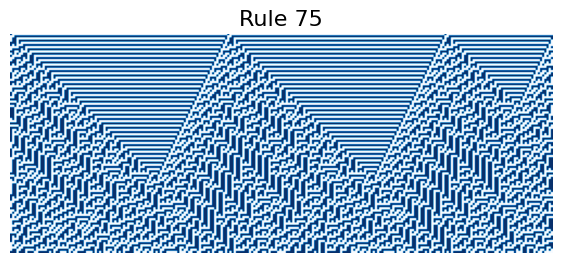

In [4]:
# Print 
plt.figure(figsize = (7, 7))
plt.title(f"Rule {rule}", fontsize = 16)
plt.imshow(evolution, cmap = "Blues")
plt.axis("off")
plt.show()

It's beautiful.

## Rule $75$'s gif
We'll change the number of $0$'s in between 1's.

In [5]:
# To get an image
def get_image(rows: int, rule: int, array: np.ndarray,
              shape = (7, 7), cmap = "Blues", title: str = "",
              fontsize: int = 16):
    """
    Gets an image of elementary cellular automata.
    """
    # Create the object
    object = elem(rule = rule, initial_config = array)

    # Get the evolution
    evolution = object.get_evolution(iterations = rows)

    # Create the plot
    fig = plt.figure(figsize = shape)
    plt.title(title, fontsize = fontsize, fontfamily = "Monospace")
    plt.imshow(evolution, cmap = cmap)
    plt.axis("off")
    plt.close()
    
    return fig

In [6]:
# Create a folder
if not os.path.exists("output-75"):
    os.mkdir("output-75")

# Set the parameters
rule = 75
rows = 100
title = f"Rule {rule} with moving 1's in the input array"
iterations = 300
shape = (7, 3)

In [ ]:
# # Start the time
# start = time.time()

# # Loop
# for i in range(9, iterations):

#     # Create an array
#     array = np.zeros(300)
#     array[::i] = 1

#     # Get the image
#     fig = get_image(rows = rows, rule = rule, array = array,
#                     title = title, shape = shape)

#     # Save it
#     fig.savefig(f"output-75/{i}.png")

# # End the time
# end = time.time()

# # Print the time
# print(f"Time: {(end - start):.2f} seconds.")

In [7]:
# To create a gif
def get_gif(input_dir, output_name, fps=10):
    """
    Create a GIF from a folder with PNG files.
    """
    # Get all files
    files = Path(input_dir).glob('*.png')

    # Sort them numerically
    files = sorted(files, key=lambda x: int(x.stem))
    
    # Create a list to save the images
    images = []

    # Read images with progress bar
    for f in tqdm(files, desc="Reading images"):
        images.append(imageio.imread(f))
    
    # Save GIF
    imageio.mimsave(f'{input_dir}/{output_name}', images, fps = fps)

In [9]:
# Call it
get_gif('output-75', 'evolution.gif')

Reading images: 100%|██████████| 291/291 [00:01<00:00, 157.10it/s]


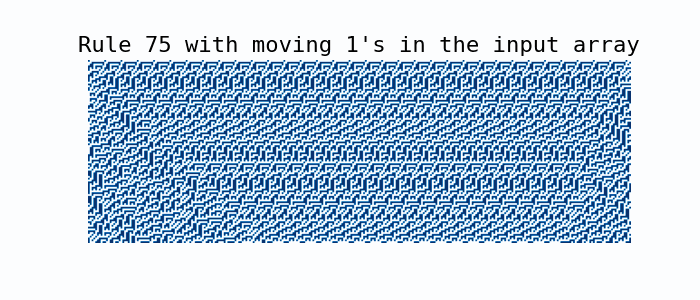

In [10]:
# Display the gif
Image("output-75/evolution.gif")

## All rules' gif with the same input

In [8]:
# Create a folder
if not os.path.exists("all-rules"):
    os.mkdir("all-rules")

# Set the parameters
rows = iterations = 301
shape = (6, 6)
cmap = "magma"
fontsize = 16

# The array we're goin to use
array = np.zeros(rows)
array[::15] = 1

In [9]:
# Start the time
start = time.time()

# Loop
for rule in range(256):
    
    # Set the title
    title = f"Rule {rule} with a 1 every 15 cells"

    # Get the image
    fig = get_image(rows = rows, rule = rule, array = array,
                    title = title, shape = shape, cmap = cmap,
                    fontsize = fontsize)
    
    # Save it
    fig.savefig(f"all-rules/{rule}.png")

# End the time
end = time.time()

# Print the time
print(f"Time: {(end - start):.2f} seconds.")

Time: 86.59 seconds.


In [10]:
# Call it
get_gif('all-rules', 'evolution.gif', fps = 4)

Reading images: 100%|██████████| 256/256 [00:01<00:00, 131.98it/s]


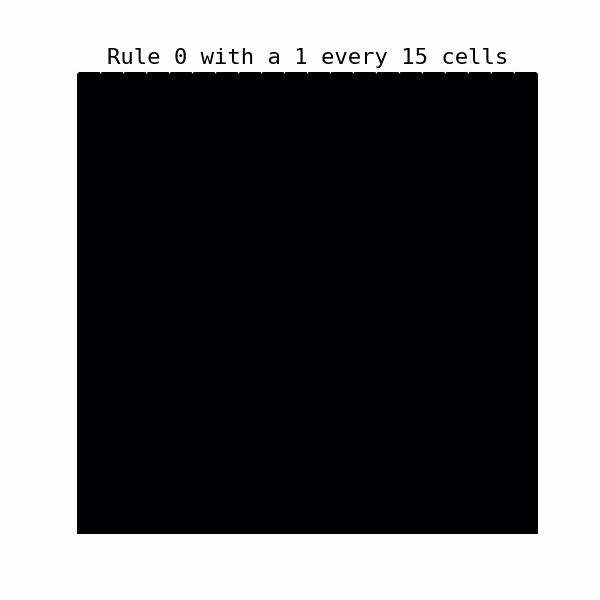

In [11]:
# Display the gif
Image("all-rules/evolution.gif")